## Location Based Assignment

The GitHub repository for this assignment can be found and downloaded: [here](https://bit.ly/cs156_lba_repo)

### Principle Landmarks

For this LBA, I took a total of 28 photos of my favorite landmark, the view from Chinatown of San Francisco. I tried to the best of my ability to have an organized and structured way to take these photos as identical as possible. For example, I used an application that allowed me to take a picture every 10 minute interval and used a tripod. However, to err is human and even though the system seemed isolated at first, human error caused the setup to fall and had to be reset albeit at a different angle. This can actually be seen in the Principal Component Analysis herein contained. The photos were taken during the day and over a period of at least four hours. 

![Landmark Timelaps](https://s4.gifyu.com/images/Landmark-Timelaps.gif "timelaps")

They are enough frames to create a one to two second time-lapse where you can see the pass of the day.

### Photos and data processing

Using the 28 photos, we do some pre-processing and we size them down to 378 x 504 pixels so that it does not exceed the given limit.

In [1]:
# If needed:

#!pip install python-resize-image
#!pip install resizeimage

In [2]:
# Importing relevant packages
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from PIL import Image
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import minmax_scale
from sklearn.decomposition import PCA
from skimage.io import imread_collection
from skimage.transform import resize

In [4]:
# Loading photos to the folder and doing pre-processing
photos_folder = 'pictures/*.jpg'

# Taking the photos in the folder together
photos_lba = imread_collection(photos_folder)

The original photos have the following dimensions: 3024 x 4032

To work with less data and keep 
original aspect ratio, reshape into: 378 X 504

There are 28 photos total, with the first photo at 10:55 am and the last photo at 15:08

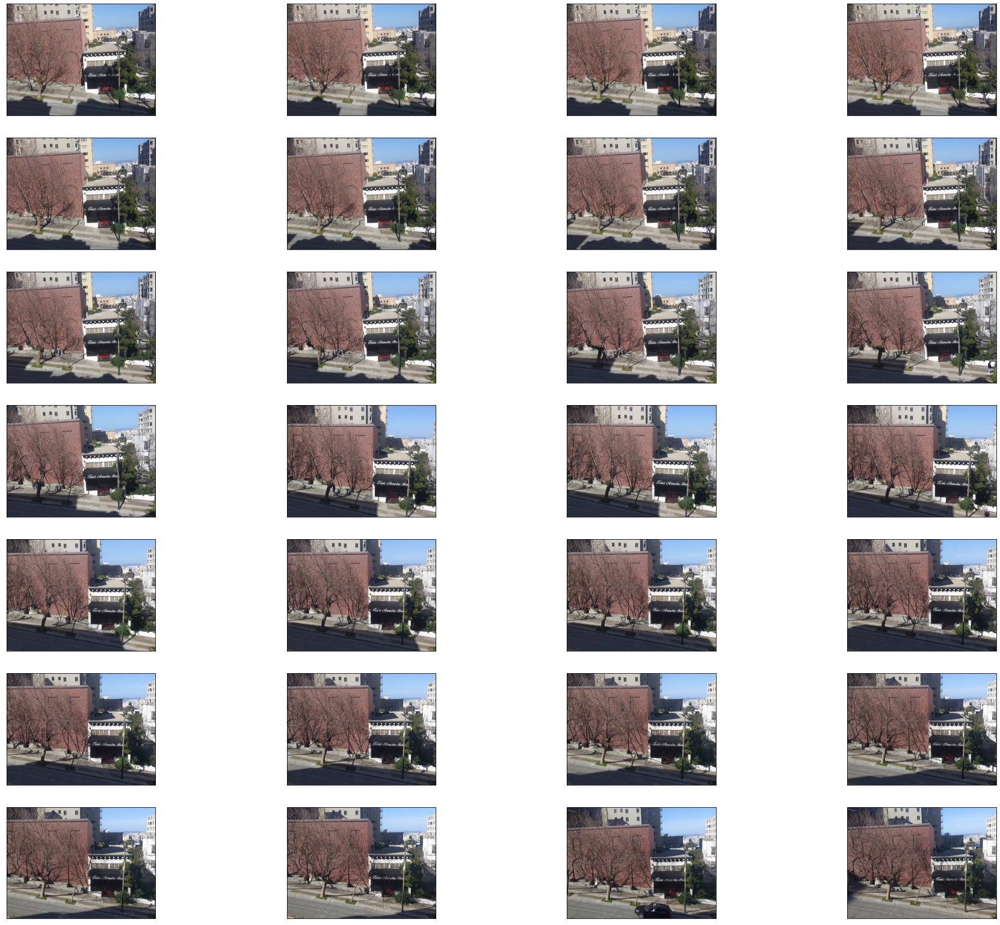

In [5]:
# Displaying all the photos in its original dimensions
fig, ax = plt.subplots(7, 4, figsize = (32, 28), subplot_kw = {'xticks':[], 'yticks':[]})

i = 0
for row in range(7):
    for col in range(4):
        ax[row, col].imshow(photos_lba[i])
        i += 1

In [6]:
# Resizing the photos while keeping same aspect ratio
height_resize = 378
width_resize = 504
    
# Resizing all photos 
photos_resize = [resize(photos_lba[i], (height_resize, width_resize), 
                        mode='constant', anti_aliasing=True, 
                        anti_aliasing_sigma=None) for i in range(len(photos_lba))]

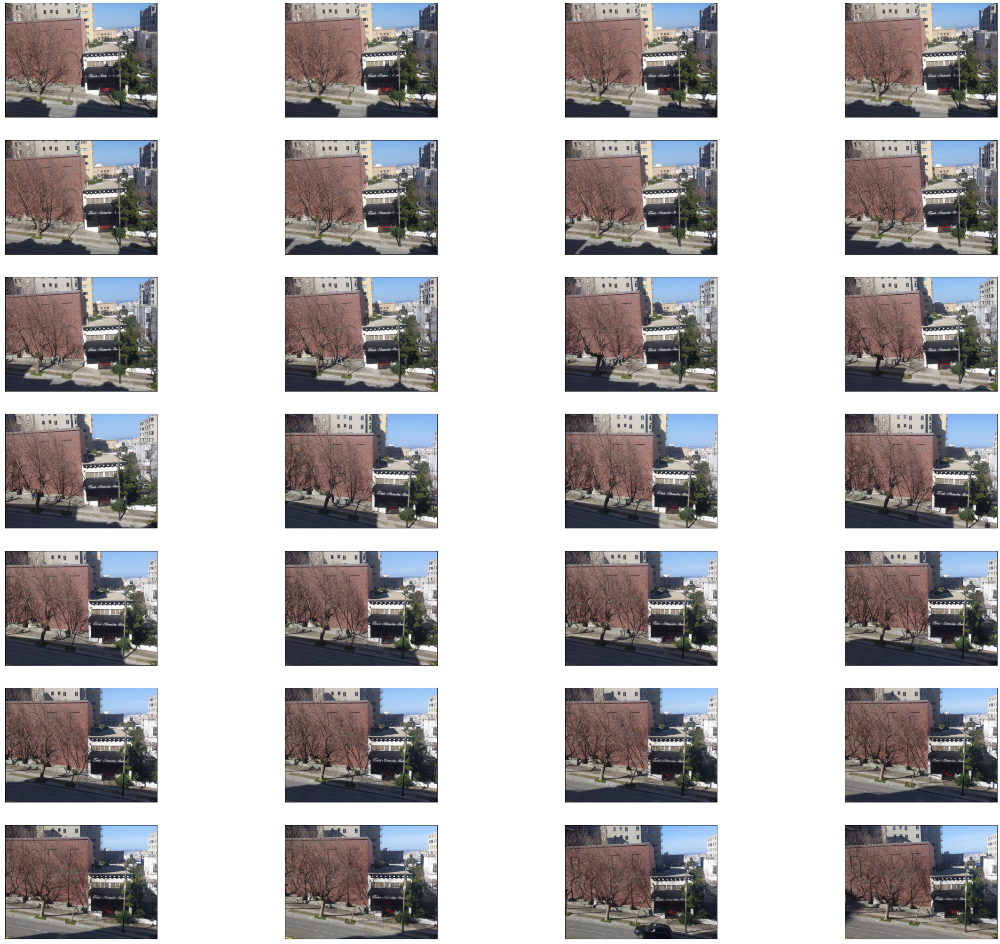

In [7]:
# Figure size and axes for the resized photos
fig, axes = plt.subplots(7, 4, figsize = (32, 28))

# All the 28 resized photos will appear here
for i, ax in enumerate(axes.flatten()):
  ax.imshow(photos_resize[i])
  ax.set_xticks([])
  ax.set_yticks([])

# Adjusting configuration of the photos output
plt.tight_layout()
plt.subplots_adjust(hspace=0.2, wspace=0.2)
plt.show()

In [8]:
# Reshaping resized photos to a flattened array
photos_array = np.array([i.flatten() for i in photos_resize])

## Principle Component Analysis (PCA)

Using principal components analysis (PCA) the photos are projected down to a 2D representation with PC1 in the x-axis and PC2 in the y-axis.

In [9]:
# From the sklearn library, using PCA with 2 principle components
pca = PCA(n_components=2)

# Fitting PCA to flattened array
principalComponents = pca.fit(photos_array)

# Transforming photos from 378x504 to 2D
transformed_photos = pca.transform(photos_array)

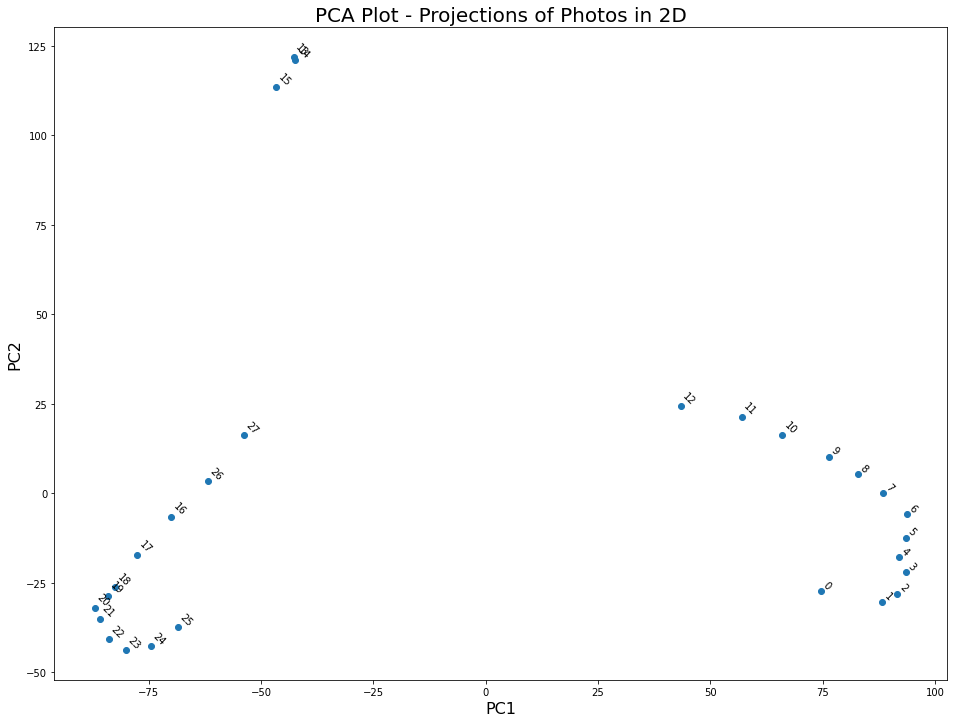

In [10]:
plt.figure(figsize = (16,12))

# Plotting projections of the array by defining x, y values
x = [projection[0] for projection in transformed_photos]
y = [projection[1] for projection in transformed_photos]
label = [idx for idx, projection in enumerate(transformed_photos)]

# Plotting projections from PCA into scatterplot
plt.scatter(x,y)

for i in range(28):
  plt.annotate(str(label[i]), xy=(x[i], y[i]), clip_on=True, rotation=-45, 
               horizontalalignment = 'left', verticalalignment = 'bottom', size = 10)

# Plotting titles and labels
plt.xlabel('PC1', size = 16)
plt.ylabel('PC2', size = 16)
plt.title('PCA Plot - Projections of Photos in 2D', size = 20)
plt.show()

### Projection of photos into 2D space

Given the graph above and the photos in code cell [5], there are interesting observations that are indicative of the differences in lighting and angles of these pictures. As well as shadows. In other words, visually inspecting the 2D locations of each photo allows to see those distinctions. The first 13 images seem to have greater lighting given that they have more sunlight making most of the landmark very bright and visible. The set-up I had also took these first photos from the same angle, so I suspect that the difference in PC2 is because of the shadows that seem to be moving from left to right. There are three images taken at a completely different angle. The last cluster of pictures behaves very similar to the first cluster where the shadow creeps from left to right, however for the most part the images are dark because the shadow covers a lot of ground.

In [11]:
# Doing inverse transform by gettind 2D projections into 378 x 504
photos_transformed = pca.inverse_transform(transformed_photos)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

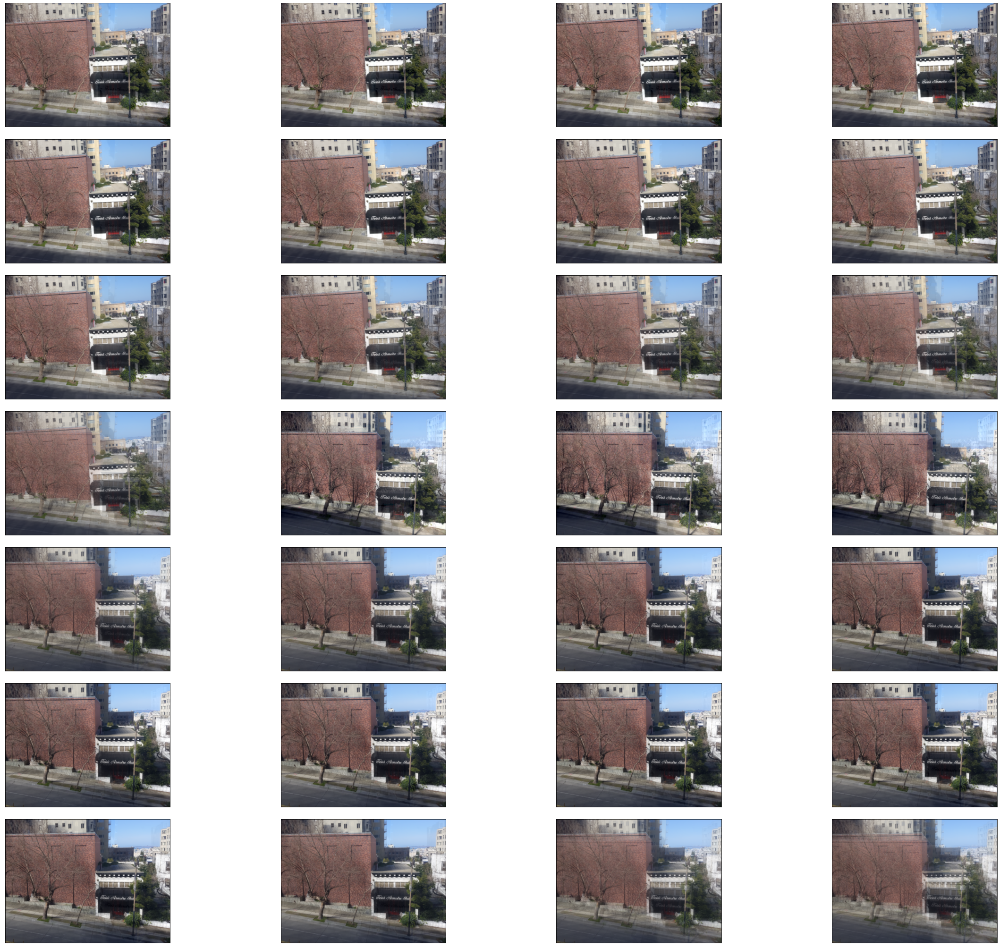

In [12]:
# Figure size and axes for the transformed photos
fig, axes = plt.subplots(7, 4, figsize = (32, 28))

# All the 28 transformed photos will appear here
for i, ax in enumerate(axes.flatten()):
  ax.imshow(photos_transformed[i].reshape(378, 504, 3))
  ax.set_xticks([])
  ax.set_yticks([])

# Adjusting configuration of the photos output
plt.tight_layout()
plt.subplots_adjust(hspace=0.1, wspace=0.1)
plt.show()

### Reconstruction of low-dimensional representations

Using the PCA reconstruction, we have similar observations with the behavior of light and shadows as well as angles.

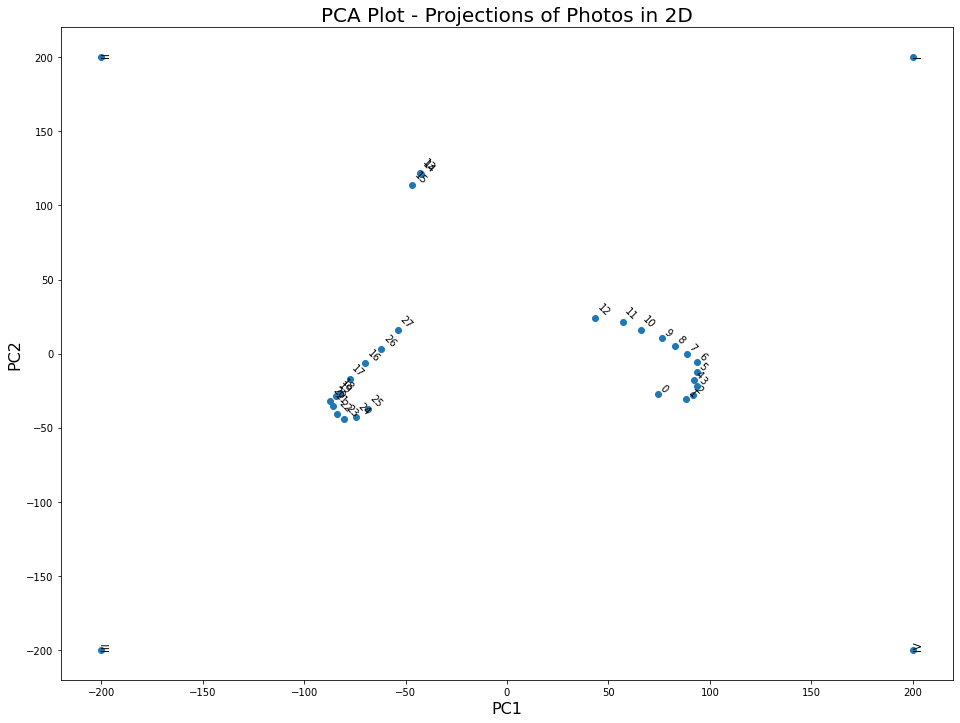

In [13]:
# Picking four points far away from the clusters to plot reconstruction
x_I = 200
y_I = 200

x_II = -200
y_II = 200

x_III = -200
y_III = -200

x_IV = 200
y_IV = -200

# Appending the four points to the 2D projections of photos
x.append(x_I)
y.append(y_I)

x.append(x_II)
y.append(y_II)

x.append(x_III)
y.append(y_III)

x.append(x_IV)
y.append(y_IV)

# Plotting the 2D projection and the additional far away points
plt.figure(figsize = (16, 12))
plt.scatter(x,y)

# Adding annotations for the points 
plt.annotate('I', xy = (x_I, y_I), clip_on = True, rotation = 90,
             horizontalalignment = 'left', verticalalignment = 'bottom', size = 10)

plt.annotate('II', xy = (x_II, y_II), clip_on = True, rotation = 90, 
             horizontalalignment = 'left', verticalalignment = 'bottom', size = 10)

plt.annotate('III', xy = (x_III, y_III), clip_on = True, rotation = 90, 
             horizontalalignment = 'left', verticalalignment = 'bottom', size = 10)

plt.annotate('IV', xy = (x_IV, y_IV), clip_on = True, rotation = 90, 
             horizontalalignment = 'left', verticalalignment = 'bottom', size = 10)

# Adding annotations for the rest of the 2D projections
for i in range(28):
  plt.annotate(str(label[i]), xy = (x[i], y[i]), clip_on = True, rotation = -45,
               horizontalalignment = 'left', verticalalignment = 'bottom', size = 10)

# Plotting titles and labels
plt.xlabel('PC1', size = 16)
plt.ylabel('PC2', size = 16)
plt.title('PCA Plot - Projections of Photos in 2D', size = 20)
plt.show()

### Picking far away points to plot their reconstruction

The points chosen represent far away points in all quadrants. I wanted to explore the differences with regards to lighting, angles, and shadows that we have seen before. Using these points, I suspect that I will see similarities with the points in Quadrant I and IV as well as similarities with Quadrant II and III.

In [14]:
# Adding the additional points into the 2D dataset of the photo projections
transformed_photos_quad = np.append(transformed_photos, [[x_I, y_I]], axis=0)
transformed_photos_quad = np.append(transformed_photos_quad, [[x_II, y_II]], axis=0)
transformed_photos_quad = np.append(transformed_photos_quad, [[x_III, y_III]], axis=0)
transformed_photos_quad = np.append(transformed_photos_quad, [[x_IV, y_IV]], axis=0)

# Transforming the images back from the 2D space to 512x512
photos_transformed_quad = pca.inverse_transform(transformed_photos_quad)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

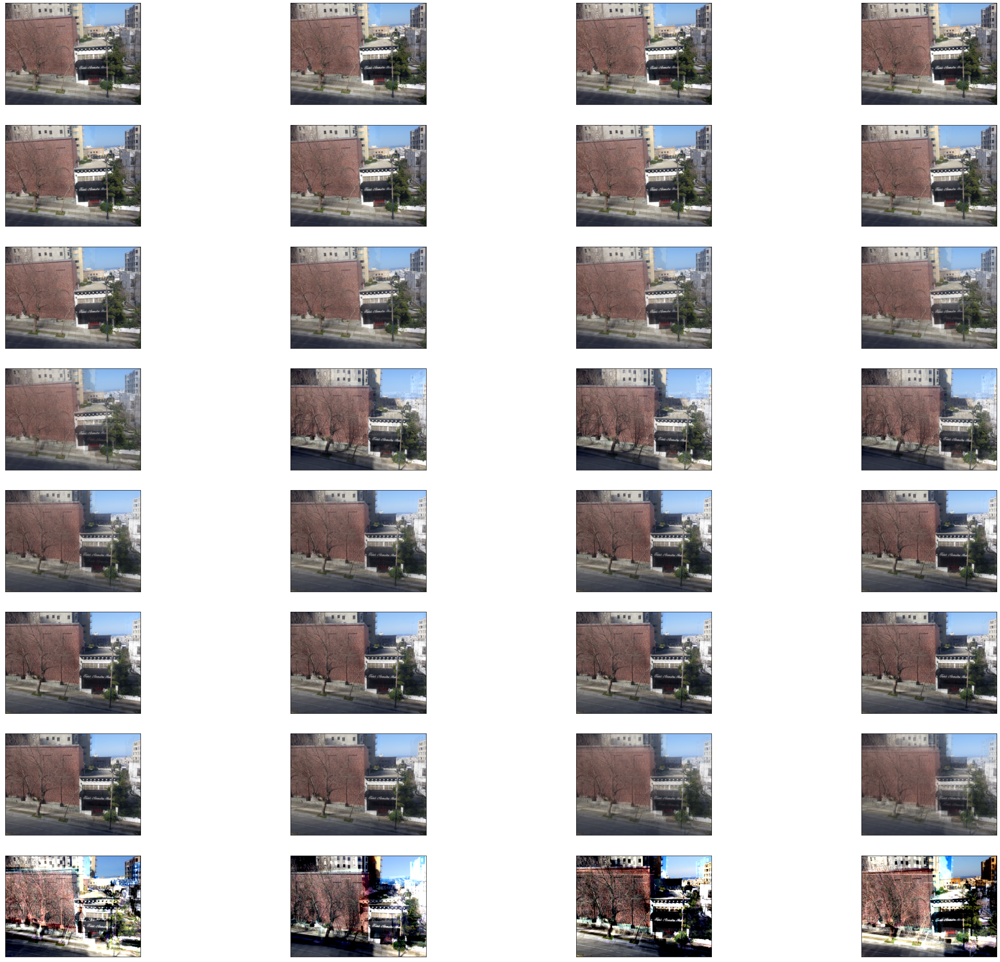

In [15]:
# Figure size and axes for the transformed photos
fig, axes = plt.subplots(8, 4, figsize = (32, 28))

# Plotting 28 reconstructions and four additional points reconstruction
for i, ax in enumerate(axes.flatten()):
  ax.imshow(photos_transformed_quad[i].reshape(378, 504, 3))
  ax.set_xticks([])
  ax.set_yticks([])

# Adjusting configuration of the photos output
plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = 0.2)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


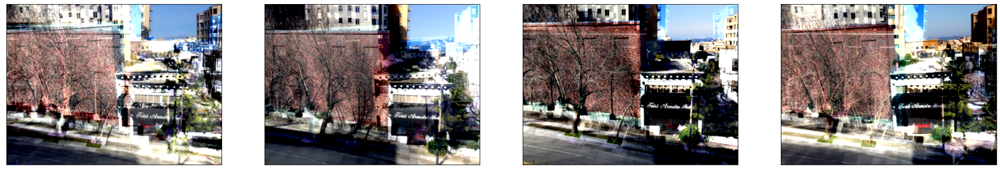

In [16]:
# Figure size and axes for the transformed photos
fig, axes = plt.subplots(1, 4, figsize = (24, 16))

# Plotting four additional reconstructions 
for i,ax in enumerate(axes.flatten()):
  ax.imshow(photos_transformed_quad[i+28].reshape(378,504,3))
  ax.set_xticks([])
  ax.set_yticks([])

# Adjusting configuration of the photos output
plt.tight_layout()
plt.subplots_adjust(hspace=0.2, wspace=0.2)
plt.show()

### Landmark reconstruction

As suspected, there are differences in lighting and shadows and angles as observed before given the behavior of the photos taken. Given the gloomy feeling of the photos, the shadows produce an interesting artistic reconstruction. 